# Task 5 - Simple Data Visualizations

In [3]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [6]:
from ift6758.data.nhl_data_parser import NHLDataParser
from ift6758.visualizations.nhl_stats import NHLStats
from ipywidgets import widgets
import matplotlib.pyplot as plt

season_range = [2016,2017,2018,2019,2020,2021,2022,2023]
shot_types = ['wrist', 'slap', 'backhand', 'snap', 'tip-in', 'deflected','wrap-around','poke', 'bat', 'between-legs', 'cradle']
team_list = ['Lightning', 'Penguins', 'Kraken', 'Golden Knights', 'Canadiens','Maple Leafs', 'Rangers', 'Capitals', 'Avalanche', 'Blackhawks',
             'Canucks', 'Oilers', 'Sabres', 'Senators', 'Red Wings', 'Panthers','Stars', 'Islanders', 'Hurricanes', 'Blue Jackets', 'Coyotes',
             'Predators', 'Jets', 'Ducks', 'Kings', 'Devils', 'Flyers', 'Wild','Bruins', 'Blues', 'Flames', 'Sharks']

In [29]:
#Download data for seasons
parser = NHLDataParser()
parser.get_shot_and_goal_pbp_df_for_seasons(2016,2020)

,gameId,timeRemaining,periodNumber,timeInPeriod,isGoal,shotType,emptyNet,xCoord,yCoord,zoneCode,shootingTeam,shotDistance,shotAngle,shootingTeamSide,shootingPlayer,goalieInNet
0,2016020001,18:49,1,01:11,0,wrist,0,-77.0,5.0,O,Maple Leafs,13.0,22.619865,1,Mitch Marner,Craig Anderson
1,2016020001,17:07,1,02:53,0,wrist,0,86.0,13.0,O,Senators,13.341664,77.005383,0,Chris Kelly,Frederik Andersen
2,2016020001,15:59,1,04:01,0,wrist,0,23.0,-38.0,N,Senators,76.157731,29.931512,0,Cody Ceci,Frederik Andersen
3,2016020001,15:14,1,04:46,0,slap,0,33.0,-15.0,O,Senators,57.974132,14.995079,0,Erik Karlsson,Frederik Andersen
4,2016020001,13:14,1,06:46,0,wrist,0,-34.0,28.0,O,Maple Leafs,61.717096,26.980231,1,Martin Marincin,Craig Anderson
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
385020,2020030415,03:41,3,16:19,0,wrist,0,57.0,30.0,O,Lightning,43.863424,43.15239,0,Blake Coleman,Carey Price
385021,2020030415,02:47,3,17:13,0,backhand,0,56.0,-31.0,O,Lightning,45.276926,43.210089,0,Mikhail Sergachev,Carey Price
385022,2020030415,00:59,3,19:01,0,wrist,0,-45.0,-14.0,O,Canadiens,46.173586,17.650124,1,Tyler Toffoli,Andrei Vasilevskiy
385023,2020030415,00:50,3,19:10,0,backhand,0,-77.0,-3.0,O,Canadiens,12.369317,14.036243,1,Cole Caufield,Andrei Vasilevskiy


In [8]:
stats = NHLStats()

In [ ]:
#make changes to options and click Run Interact to plot. May take some time to update depending on the graph
#ONLY RUN WIDGETS IN JUPYTER LAB (NOT VS CODE)
widgets.interact_manual(stats.plot_shot_type_distribution,start_season=season_range,end_season = season_range)

interactive(children=(Dropdown(description='start_season', options=(2016, 2017, 2018, 2019, 2020, 2021, 2022, …

<function ipywidgets.widgets.interaction._InteractFactory.__call__.<locals>.<lambda>(*args, **kwargs)>

In [ ]:
widgets.interact_manual(stats.plot_shot_distance_distribution,start_season=season_range,end_season=season_range,by_type=False,by_goal=False) 

interactive(children=(Dropdown(description='start_season', options=(2016, 2017, 2018, 2019, 2020, 2021, 2022, …

<function ipywidgets.widgets.interaction._InteractFactory.__call__.<locals>.<lambda>(*args, **kwargs)>

In [ ]:
widgets.interact_manual(stats.plot_shot_distance_probability,start_season=season_range,end_season=season_range,bin_width = (1,20,0.5),norm =False) 


interactive(children=(Dropdown(description='start_season', options=(2016, 2017, 2018, 2019, 2020, 2021, 2022, …

<function ipywidgets.widgets.interaction._InteractFactory.__call__.<locals>.<lambda>(*args, **kwargs)>

interactive(children=(Dropdown(description='start_season', options=(2016, 2017, 2018, 2019, 2020, 2021, 2022, …

<function ipywidgets.widgets.interaction._InteractFactory.__call__.<locals>.<lambda>(*args, **kwargs)>

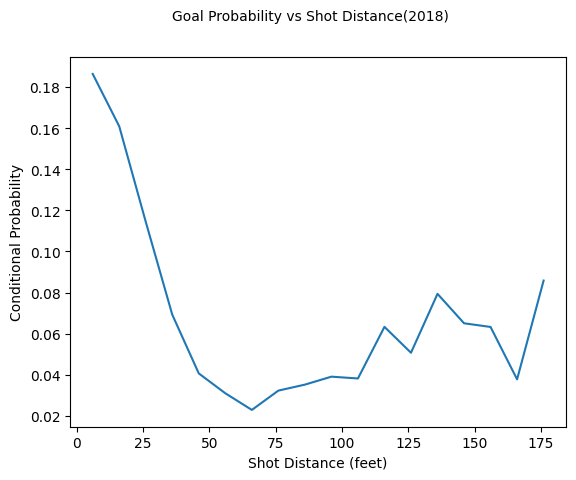

In [13]:
stats.plot_shot_distance_probability(2018,2018,10,False)
plt.savefig('2018_shot_distance_conditional_probability.png',dpi=200)


interactive(children=(Dropdown(description='start_season', options=(2016, 2017, 2018, 2019, 2020, 2021, 2022, …

<function ipywidgets.widgets.interaction._InteractFactory.__call__.<locals>.<lambda>(*args, **kwargs)>

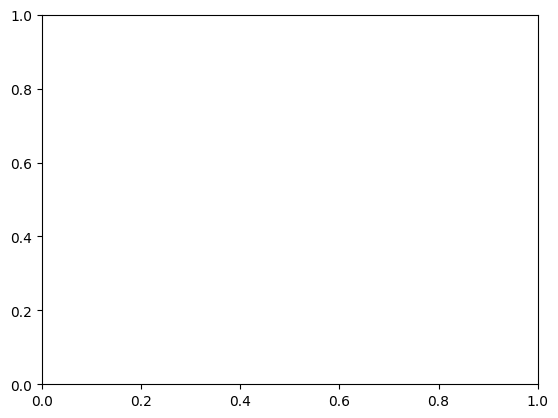

In [ ]:
#CTRL click to select multiple options. Note that there were some new type of shots added from 2022 (poke,bat,between legs/wrap around) so seasons before that dont track them
widgets.interact_manual(stats.plot_shot_distance_type_probability,
                        start_season=season_range,end_season = season_range,
                        bin_width = (1,30,0.5),
                        shot_types=widgets.SelectMultiple(options = shot_types),norm =False)

In [28]:
shot_df = parser.get_shot_and_goal_pbp_df_for_seasons(2016,2020)

shot_df = shot_df[shot_df['shotType'].notna()]
shot_df = shot_df[shot_df['xCoord'].notna()]
shot_df = shot_df[shot_df['yCoord'].notna()]


print(shot_df.isnull().sum())

shot_df

gameId                 0
timeRemaining          0
periodNumber           0
timeInPeriod           0
isGoal                 0
shotType               0
emptyNet               0
xCoord                 0
yCoord                 0
zoneCode               0
shootingTeam           0
shotDistance           0
shotAngle              0
shootingTeamSide       0
shootingPlayer         0
goalieInNet         1769
dtype: int64


,gameId,timeRemaining,periodNumber,timeInPeriod,isGoal,shotType,emptyNet,xCoord,yCoord,zoneCode,shootingTeam,shotDistance,shotAngle,shootingTeamSide,shootingPlayer,goalieInNet
0,2016020001,18:49,1,01:11,0,wrist,0,-77.0,5.0,O,Maple Leafs,13.000000,22.619865,1,Mitch Marner,Craig Anderson
1,2016020001,17:07,1,02:53,0,wrist,0,86.0,13.0,O,Senators,13.341664,77.005383,0,Chris Kelly,Frederik Andersen
2,2016020001,15:59,1,04:01,0,wrist,0,23.0,-38.0,N,Senators,76.157731,29.931512,0,Cody Ceci,Frederik Andersen
3,2016020001,15:14,1,04:46,0,slap,0,33.0,-15.0,O,Senators,57.974132,14.995079,0,Erik Karlsson,Frederik Andersen
4,2016020001,13:14,1,06:46,0,wrist,0,-34.0,28.0,O,Maple Leafs,61.717096,26.980231,1,Martin Marincin,Craig Anderson
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
385071,2020030415,03:41,3,16:19,0,wrist,0,57.0,30.0,O,Lightning,43.863424,43.152390,0,Blake Coleman,Carey Price
385072,2020030415,02:47,3,17:13,0,backhand,0,56.0,-31.0,O,Lightning,45.276926,43.210089,0,Mikhail Sergachev,Carey Price
385073,2020030415,00:59,3,19:01,0,wrist,0,-45.0,-14.0,O,Canadiens,46.173586,17.650124,1,Tyler Toffoli,Andrei Vasilevskiy
385074,2020030415,00:50,3,19:10,0,backhand,0,-77.0,-3.0,O,Canadiens,12.369317,14.036243,1,Cole Caufield,Andrei Vasilevskiy


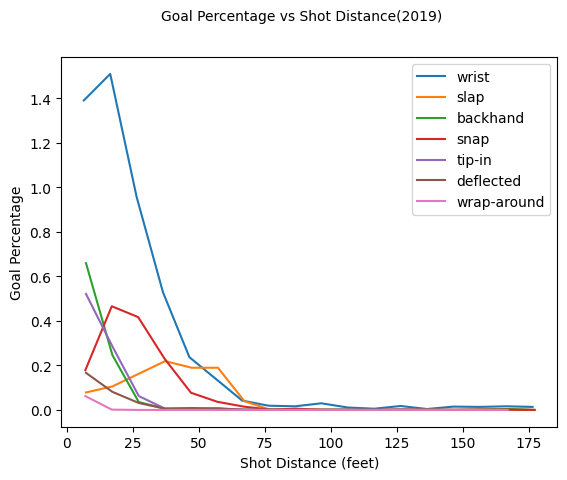

In [19]:
stats.plot_shot_distance_type_probability(2019,2019,10,['wrist', 'slap', 'backhand', 'snap', 'tip-in', 'deflected','wrap-around'],True)
plt.savefig('2018_shot_distance_type_percentage.png',dpi=200)

In [16]:
# Run the function manually to see the data frame
#The values under each team is the difference between the average shot rate per hour for the team and the league for that coordinate.
df_shot= stats.get_excess_shot_rate_df(2016)

In [17]:
w = widgets.interactive(stats.plot_excess_shot_rate,
                        {'manual':True},
                        season=season_range,
                        xbin = (5,20,0.5),
                        ybin = (5,20,0.5),
                        sigma=(0.5,8,0.5))
w

interactive(children=(Dropdown(description='season', options=(2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023),…

In [4]:
fig = stats.plot_excess_shot_rate(2018,10,10,2)

In [5]:
fig.write_html('shot_map.html')